Лабораторная работа №1 по дисциплине "Основы машинного обучения"

Выполнили cтуденты группы 3311
- Аршин Александр
- Баймухамедов Рафаэль
- Пасечный Леонид

Требования:
- Число столбцов признаков – не менее 10;
- Число записей – не менее 10000;
- Набор данных имеет пропуски.

Задачи:
- Очистка данных (удаление пропусков, нормализация, удаление дубликатов)
- Визуализация значимых признаков
- Диаграммы рассеяния
- Ящики с усами
- Гистограммы
- Корреляция данных (матрица корреляций)

Скачаем датасет (https://www.kaggle.com/datasets/mahdimashayekhi/disease-risk-from-daily-habits/data)

In [1]:
from pathlib import Path
import requests

RAW_URL = "https://raw.githubusercontent.com/brick1ng5654/course-3/RafaelB/boml/lab_01/health_lifestyle_classification.csv"
DEST = Path("/content/data/health_lifestyle_classification.csv")
DEST.parent.mkdir(parents=True, exist_ok=True)

r = requests.get(RAW_URL, timeout=60)
r.raise_for_status()

DEST.write_bytes(r.content)
print(f"Saved to {DEST} ({DEST.stat().st_size/1_000_000:.2f} MB)")

Saved to \content\data\health_lifestyle_classification.csv (52.98 MB)


В датасете более 100+ тысяч строк и 41 признак. Выберем необходимое и отсеем лишнее.

Целевым признаком для предсказания будет target (Бинарная классификация): healthy (здоров) / diseased (болен). Важное уточнение, что данное понятие достаточно расплывчатое.

Из числовых признаков возьмём:
- age (Возраст)
- bmi (Индекс массы тела)
- blood pressure (Артериальное давление)
- calorie intake (Потребление калорий)
- cholesterol (Холестерин)
- daily steps (Ежедневное количество шагов)
- glucose (Глюкоза)
- heart rate (Пульс)
- insulin (Инсулин)
- sleep hours (Количество часов сна)
- stress level (Заявленный уровень стресса)
- sugar intake (Потреблнение сахара)
- water intake (Потребление воды)
- work hours (Количество часов работы)
- meals per day (Количество приёмов пищи в день)

Из категориальных признаков возьмём:
- alchohol consumption (Потребление алкоголя, [Occasionally, Regularly, None])
- caffeine intake (Потребление кофеина, [Moderate, High, None])
- diet type (Тип диенты, [Vegan, Omnivore, Vegetarian, Keto])
- exercise type (Тип тренировок, [Strength, Cardio, None, Mixed])
- gender (Пол, [Male, Female])
- sleep quality (Качество сна, [Good, Excellent, Fair, Poor])
- smoking level (Потребление сигарет, [Light, Non-smoker, Heavy])
- sunlight exposure (Ежедневное воздействие солнечного света, [Low, Moderate, High])

Таким образом были убраны следующие признаки:
- bmi ?* (В виду взятия признака bmi, вслесдствие чего остальные показатели bmi не нужны)
- daily supplement dosage (В виду не до конца понятной классификации)
- device usage (В виду наименьшего влияния на результат заболевания)
- education level (В виду наименьшего влияния на результат заболевания)
- electrolyte level (В виду бесполезности признака, т.к. все строки одинаковые)
- enviromnent risk score (В виду бесполезности признака, т.к. все строки одинаковые)
- family history (В виду не до конца понятной бинарной классификации)
- gene marker flag (В виду бесполнезности признака, т.к. все строки одинаковые)
- healthcare access (В виду наименьшего влияния на результат заболевания)
- height (В виду ненужности признака из-за наличия признака bmi)
- income ((В виду наименьшего влияния на результат заболевания)
- insurance (В виду наименьшего влияния на результат заболевания)
- job type ((В виду наименьшего влияния на результат заболевания)
- mental health score (В виду схожести с заявленным уровнем стресса)
- mental health support (В виду наименьшего влияния на результат заболевания)
- occupation (В виду наименьшего влияния на результат заболевания)
- pet owner (В виду наименьшего влияния на результат заболевания)
- physical activity (В виду не до конца понятного получения значения признака)
- screen time (В виду наименьшего влияния на результат заболевания)
- waist size (В виду наименьшего влияния на результат заболевания)
- weight (В виду ненужности признака из-за наличия признака bmi)

Загрузим библиотеки

In [2]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.plotting.register_matplotlib_converters()
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
print("Setup Complete")

Setup Complete


Загрузка датасета

In [3]:
filepath = "/content/data/health_lifestyle_classification.csv"

df = pd.read_csv(filepath)

В переменной filepath хранится путь до датасета. В переменной df хранится dataframe по нашему датасету

Удалим лишние признаки

In [4]:
delete_columns = [
    'screen_time',
    'family_history',
    'mental_health_score',
    'occupation',
    'mental_health_support',
    'device_usage',
    'healthcare_access',
    'insurance',
    'pet_owner',
    'height',
    'weight',
    'waist_size',
    'bmi_estimated',
    'bmi_scaled',
    'bmi_corrected',
    'physical_activity',
    'education_level',
    'job_type',
    'income',
    'electrolyte_level',
    'gene_marker_flag',
    'environmental_risk_score',
    'daily_supplement_dosage'
]

df = df.drop(columns=delete_columns)

Посмотрим типы столбцов

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 25 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   survey_code          100000 non-null  int64  
 1   age                  100000 non-null  int64  
 2   gender               100000 non-null  object 
 3   bmi                  100000 non-null  float64
 4   blood_pressure       92331 non-null   float64
 5   heart_rate           85997 non-null   float64
 6   cholesterol          100000 non-null  float64
 7   glucose              100000 non-null  float64
 8   insulin              84164 non-null   float64
 9   sleep_hours          100000 non-null  float64
 10  sleep_quality        100000 non-null  object 
 11  work_hours           100000 non-null  float64
 12  daily_steps          91671 non-null   float64
 13  calorie_intake       100000 non-null  float64
 14  sugar_intake         100000 non-null  float64
 15  alcohol_consumptio

Посмотрим пустые значения столбцов

In [6]:
df.isna().sum()

survey_code                0
age                        0
gender                     0
bmi                        0
blood_pressure          7669
heart_rate             14003
cholesterol                0
glucose                    0
insulin                15836
sleep_hours                0
sleep_quality              0
work_hours                 0
daily_steps             8329
calorie_intake             0
sugar_intake               0
alcohol_consumption    42387
smoking_level              0
water_intake               0
stress_level               0
diet_type                  0
exercise_type          24969
sunlight_exposure          0
meals_per_day              0
caffeine_intake        33261
target                     0
dtype: int64

все требования к лабораторной работе выполнены.
- [x] Число столбцов признаков - не менее 10
- [x] Число записей - не менее 10000
- [x] Набор данных имеет пропуски

Обозначм столбцы с ID и целевым признаком

In [7]:
id_column = "survey_code"
target_column = "target"

Выделим категориальные и числовые признаки

In [8]:
numerical_columns = [
    'age','bmi','blood_pressure','heart_rate','cholesterol','glucose','insulin','sleep_hours','work_hours','daily_steps','calorie_intake','sugar_intake','water_intake','stress_level','meals_per_day'
]

categorical_columns = [
    'gender','sleep_quality','alcohol_consumption','smoking_level','diet_type','exercise_type','sunlight_exposure','caffeine_intake'
]

Очистим столбцы с пустыми категориальными признаками

In [9]:
for column in df.columns:
    if df[column].dtype not in ('int64', 'float64'):
        df = df.dropna(subset=[column])

Удаляем строки где есть значения числовых столбцов меньше нуля и проверяем, сколько значений меньше нуля остались

In [10]:
df = df[(df[numerical_columns] >= 0).all(axis=1)]
negative_counts = (df[numerical_columns] < 0).sum()
print(negative_counts)

age               0
bmi               0
blood_pressure    0
heart_rate        0
cholesterol       0
glucose           0
insulin           0
sleep_hours       0
work_hours        0
daily_steps       0
calorie_intake    0
sugar_intake      0
water_intake      0
stress_level      0
meals_per_day     0
dtype: int64


Проверим есть ли дубликаты и удалим их при наличии

In [11]:
print("Точных дублей:", df.duplicated().sum())
df = df.drop_duplicates()

print("дубликатов ID:", df.duplicated(subset=[id_column]).sum())
df = df.drop_duplicates(subset=[id_column], keep='first')

X_cols = df.columns.difference([id_column, target_column])
print("дублей по X:", df.duplicated(subset=X_cols).sum())

Точных дублей: 0
дубликатов ID: 0
дублей по X: 0


Разделим данные на обучающие и тренировочные

In [12]:
X = df.drop(columns=[id_column, target_column])
y = df[target_column]

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y, stratify=y, random_state=26, test_size=0.2
)

y_bin = (df['target'] == 'diseased').astype('int8')

Заполним медианой строки с пустыми численными признаками

In [13]:
for column in X_train.columns:
    if X_train[column].dtype in ('int64', 'float64'):
        X_train[column] = X_train[column].fillna(X_train[column].median())

Проверим результат

In [14]:
X_train.isna().sum()

age                    0
gender                 0
bmi                    0
blood_pressure         0
heart_rate             0
cholesterol            0
glucose                0
insulin                0
sleep_hours            0
sleep_quality          0
work_hours             0
daily_steps            0
calorie_intake         0
sugar_intake           0
alcohol_consumption    0
smoking_level          0
water_intake           0
stress_level           0
diet_type              0
exercise_type          0
sunlight_exposure      0
meals_per_day          0
caffeine_intake        0
dtype: int64

Всё верно сделано

Сделаем функцию для обнаружения выбросов

In [15]:
def sigma_bounds(df, cols, k=3.0):
    b = {}
    for c in cols:
        s = df[c].dropna()
        m = s.mean() # mean
        sd = s.std(ddof=1) # std value
        b[c] = (m - k*sd, m + k*sd) # (lower bound, upper bound)
    return b

def outlier_indices_by_bounds(df, bounds):
    out = set()
    for c, (lower_bound, upper_bound) in bounds.items():
        if c in df.columns:
            idx = df.index[(df[c] < lower_bound) | (df[c] > upper_bound)]
            out |= set(idx)
    return out

Первичный отбор (до чистки) по всем численным признакам

In [16]:
sns.pairplot(X_train[numerical_columns])

Сбор всех выбросов во всех колонках и их удаление

In [17]:
import numpy as np
out = set()

bounds = sigma_bounds(X_train, numerical_columns, k=3.0)
out = outlier_indices_by_bounds(X_train, bounds)

X_train = X_train.drop(index=list(out))
y_train = y_train.loc[X_train.index]

print(len(X_train) == len(y_train))

True


Повторный просмотр корреляции

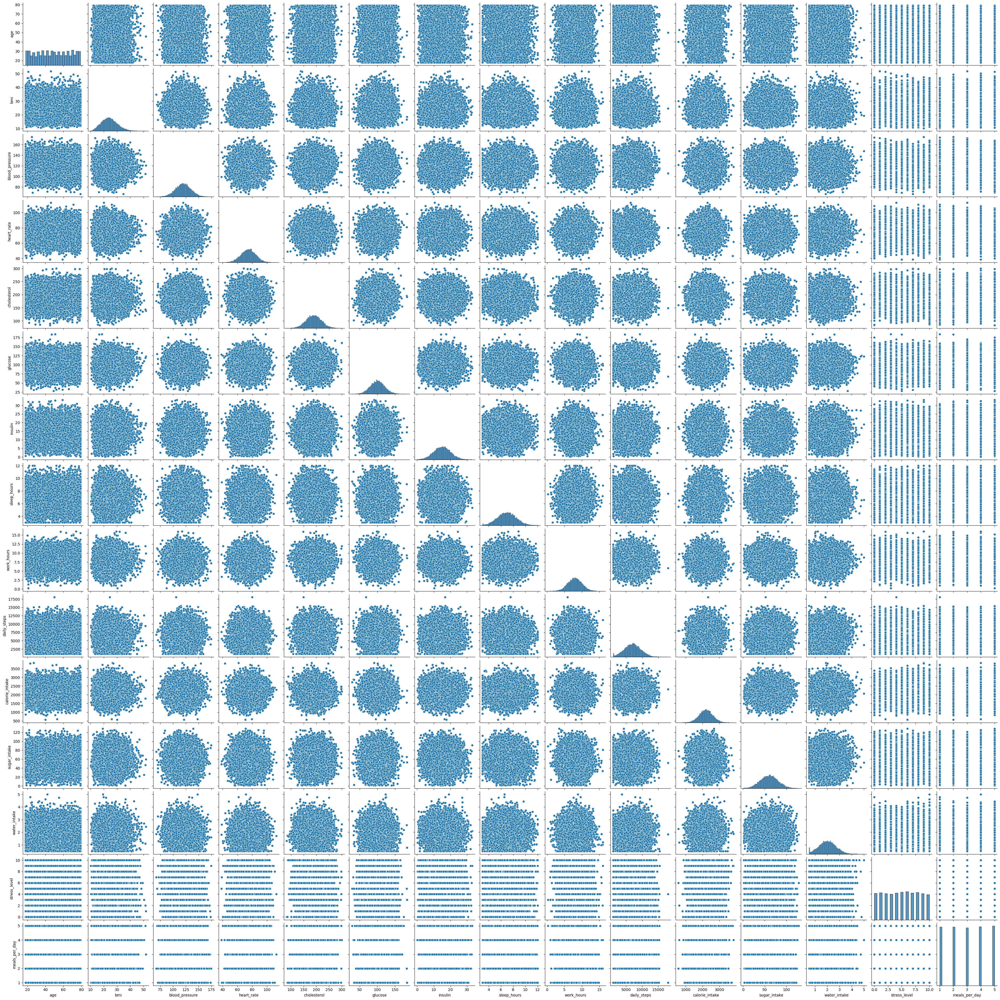

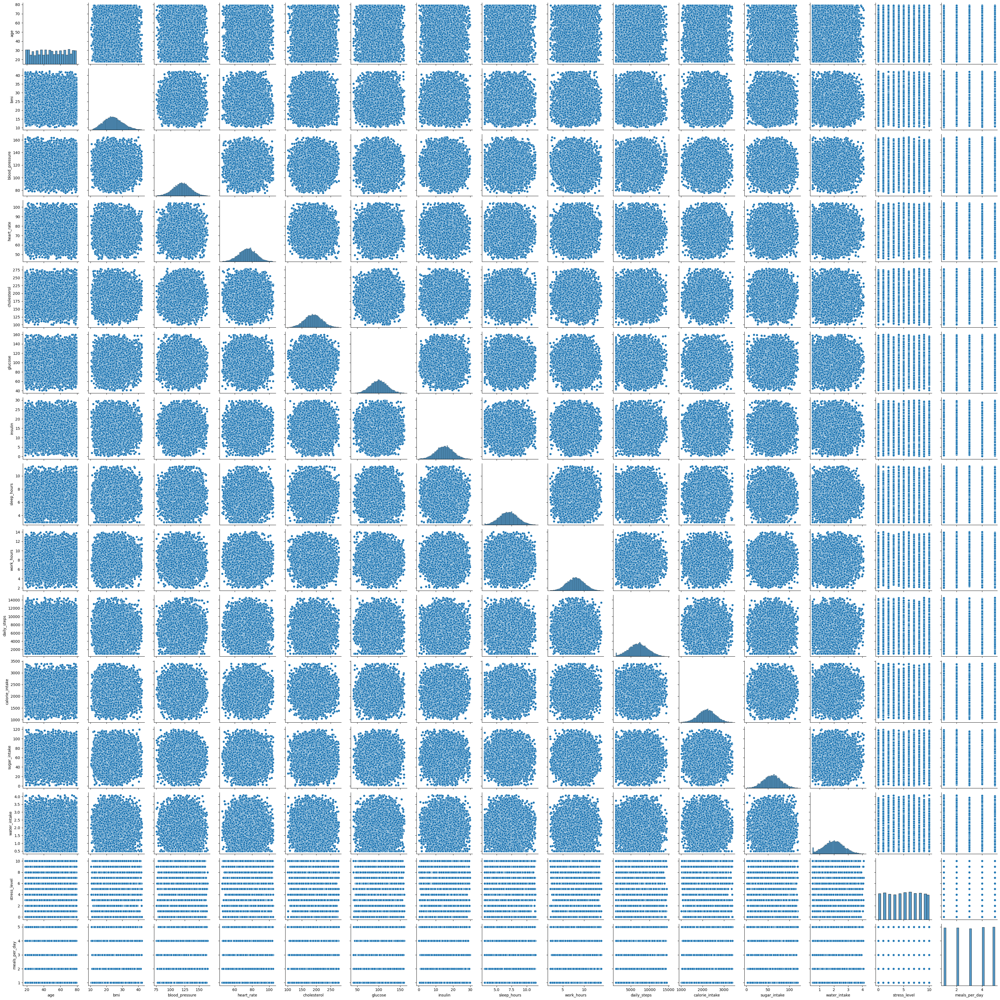

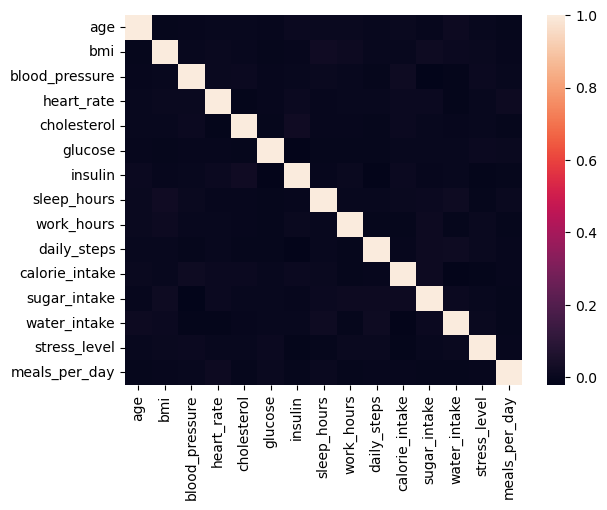

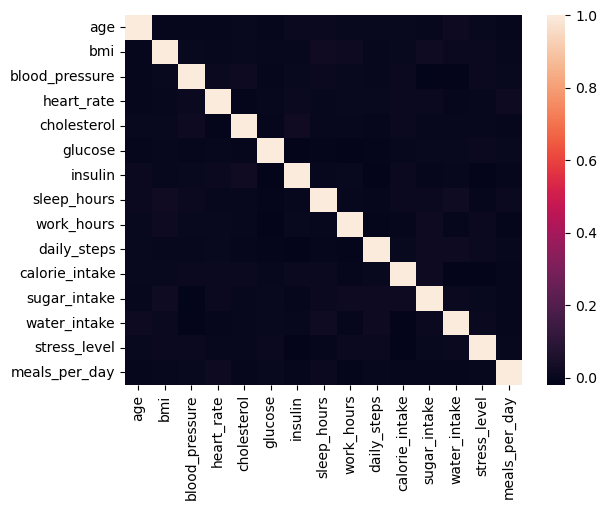

In [18]:
sns.pairplot(X_train[numerical_columns]); plt.show()
sns.heatmap(X_train[numerical_columns].corr(method='spearman')); plt.show()
sns.heatmap(X_train[numerical_columns].corr(method='pearson')); plt.show()

В данных почти нет сильных линейных связей между признаками. Вне диагонали почти всё близко к нулю

Применим полученный результат выбросов и на тестовые данные

In [19]:
for col, (lower, upper) in bounds.items():
    if col in X_test.columns:
        if np.issubdtype(X_test[col].dtype, np.integer):
            X_test.loc[:, col] = (
                X_test[col]
                .clip(lower=int(np.floor(lower)), upper=int(np.ceil(upper)))
                .astype(X_test[col].dtype)
            )
        else:
            X_test.loc[:, col] = X_test[col].clip(lower=lower, upper=upper)

Теперь сделаем диаграмму рассеяния, но для начала посмотрим матрицу корреляций для выявления признаков с наибольшей (пусть и маленькой) взаимосвзяью


Для начала посмотрим корреляцию между числовыми признаками

In [20]:
corr = df[numerical_columns].corr(method='pearson')
corr

,age,bmi,blood_pressure,heart_rate,cholesterol,glucose,insulin,sleep_hours,work_hours,daily_steps,calorie_intake,sugar_intake,water_intake,stress_level,meals_per_day
age,1.000000,-0.001210,-0.004713,-0.003407,0.001261,-0.004389,0.006053,0.006198,0.009013,0.006501,0.004048,0.001334,0.007465,0.004583,-0.005950
bmi,-0.001210,1.000000,-0.003276,0.001840,0.000609,-0.009046,0.000395,0.013127,0.005381,-0.000806,0.002820,0.014720,0.005808,0.004199,-0.002365
blood_pressure,-0.004713,-0.003276,1.000000,-0.000390,0.010564,-0.000630,0.009717,0.005371,0.001155,-0.003190,0.009429,-0.018295,-0.009917,0.009666,0.000937
heart_rate,-0.003407,0.001840,-0.000390,1.000000,0.000119,-0.003761,0.005528,-0.000207,-0.005851,-0.000349,0.013022,0.012231,-0.005569,0.005272,0.009563
cholesterol,0.001261,0.000609,0.010564,0.000119,1.000000,-0.003452,0.022920,-0.007557,-0.005041,-0.003015,0.004156,-0.001996,-0.006992,0.006398,0.003394
glucose,-0.004389,-0.009046,-0.000630,-0.003761,-0.003452,1.000000,-0.012999,-0.007583,-0.010101,-0.010370,-0.003923,0.008268,0.000619,0.008594,0.000597
insulin,0.006053,0.000395,0.009717,0.005528,0.022920,-0.012999,1.000000,-0.007774,-0.000693,-0.015745,0.002489,-0.005776,0.007326,-0.007837,-0.004460
sleep_hours,0.006198,0.013127,0.005371,-0.000207,-0.007557,-0.007583,-0.007774,1.000000,0.005149,-0.004426,0.000910,0.001929,0.016138,-0.009864,0.004182
work_hours,0.009013,0.005381,0.001155,-0.005851,-0.005041,-0.010101,-0.000693,0.005149,1.000000,-0.006669,-0.007276,0.010369,-0.004843,-0.001638,-0.013432
daily_steps,0.006501,-0.000806,-0.003190,-0.000349,-0.003015,-0.010370,-0.015745,-0.004426,-0.006669,1.000000,-0.000927,0.012951,0.010105,0.007464,-0.004727


Теперь посмотрим корреляцию между целевым признаком и численными признаками

In [21]:
corr_with_y = df[numerical_columns].corrwith(y_bin)
corr_with_y.sort_values(ascending=False)

heart_rate        0.007496
sleep_hours       0.006529
age               0.002688
insulin          -0.000632
bmi              -0.001378
calorie_intake   -0.001447
daily_steps      -0.002711
cholesterol      -0.003764
blood_pressure   -0.003809
sugar_intake     -0.006500
stress_level     -0.008619
glucose          -0.009040
water_intake     -0.010581
work_hours       -0.010651
meals_per_day    -0.010977
dtype: float64

Как мы видим сильной взаимосвязи между признаками нет, поэтому немного проанализируем полученное и решим по каким признакам построить диаграмму рассеяности:

Работа с таблицами проводилась в следующей Google-таблице (https://docs.google.com/spreadsheets/d/1FoD9t5EEV2SQCFTW3m40rX29H55DqPsx__TQ-HKVS1s/edit?usp=sharing)

В коллабе будет продублирована работа в чуть упрощенном виде (без форматирования и формул, используемых в гугл таблицах)

In [22]:
import io
pd.read_csv(io.StringIO('''
,age,bmi,blood_pressure,heart_rate,cholesterol,glucose,insulin,sleep_hours,work_hours,daily_steps,calorie_intake,sugar_intake,water_intake,stress_level,meals_per_day,target
age,1.000000,0.005813,0.004073,0.003724,0.003975,0.003360,0.007096,-0.000028,0.008027,0.006774,0.005464,0.000516,0.006250,0.001445,-0.002469,-0.004273
bmi,0.005813,1.000000,0.001597,0.002725,-0.002661,-0.006623,0.001626,0.005992,0.000517,-0.001132,0.007845,0.006033,-0.001030,0.004516,-0.004160,-0.002259
blood_pressure,0.004073,0.001597,1.000000,-0.004422,0.003761,0.000324,0.008213,0.011707,0.000379,-0.005427,0.003217,-0.014570,-0.004899,0.005546,0.004311,0.003943
heart_rate,0.003724,0.002725,-0.004422,1.000000,-0.004179,-0.004668,0.005576,-0.003813,-0.005878,-0.005139,0.012429,0.004530,-0.002552,0.004429,0.005565,0.000755
cholesterol,0.003975,-0.002661,0.003761,-0.004179,1.000000,-0.007027,0.020514,-0.000885,-0.000121,-0.005513,-0.000700,-0.000732,-0.003526,0.001546,-0.002427,-0.004061
glucose,0.003360,-0.006623,0.000324,-0.004668,-0.007027,1.000000,-0.009471,-0.012819,-0.009000,-0.006140,-0.006927,0.008066,0.000842,-0.001294,-0.000520,-0.002524
insulin,0.007096,0.001626,0.008213,0.005576,0.020514,-0.009471,1.000000,-0.002588,-0.000668,-0.011813,0.003446,-0.002923,0.011518,-0.005206,-0.003807,0.002462
sleep_hours,-0.000028,0.005992,0.011707,-0.003813,-0.000885,-0.012819,-0.002588,1.000000,0.000975,-0.004664,0.004178,0.000853,0.014802,-0.011555,0.005172,-0.004086
work_hours,0.008027,0.000517,0.000379,-0.005878,-0.000121,-0.009000,-0.000668,0.000975,1.000000,-0.002030,-0.005692,0.005755,-0.001761,-0.006277,-0.007300,0.014562
daily_steps,0.006774,-0.001132,-0.005427,-0.005139,-0.005513,-0.006140,-0.011813,-0.004664,-0.002030,1.000000,-0.000359,0.003750,0.007756,0.004492,-0.002344,0.007677
calorie_intake,0.005464,0.007845,0.003217,0.012429,-0.000700,-0.006927,0.003446,0.004178,-0.005692,-0.000359,1.000000,0.010607,-0.009491,-0.002603,-0.008066,0.003517
sugar_intake,0.000516,0.006033,-0.014570,0.004530,-0.000732,0.008066,-0.002923,0.000853,0.005755,0.003750,0.010607,1.000000,-0.001101,0.004832,-0.000124,0.003103
water_intake,0.006250,-0.001030,-0.004899,-0.002552,-0.003526,0.000842,0.011518,0.014802,-0.001761,0.007756,-0.009491,-0.001101,1.000000,0.005128,-0.007000,0.000559
stress_level,0.001445,0.004516,0.005546,0.004429,0.001546,-0.001294,-0.005206,-0.011555,-0.006277,0.004492,-0.002603,0.004832,0.005128,1.000000,-0.002149,-0.002207
meals_per_day,-0.002469,-0.004160,0.004311,0.005565,-0.002427,-0.000520,-0.003807,0.005172,-0.007300,-0.002344,-0.008066,-0.000124,-0.007000,-0.002149,1.000000,0.009275
'''), header=None)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,NaN,age,bmi,blood_pressure,heart_rate,cholesterol,glucose,insulin,sleep_hours,work_hours,daily_steps,calorie_intake,sugar_intake,water_intake,stress_level,meals_per_day,target
1,age,1.000000,0.005813,0.004073,0.003724,0.003975,0.003360,0.007096,-0.000028,0.008027,0.006774,0.005464,0.000516,0.006250,0.001445,-0.002469,-0.004273
2,bmi,0.005813,1.000000,0.001597,0.002725,-0.002661,-0.006623,0.001626,0.005992,0.000517,-0.001132,0.007845,0.006033,-0.001030,0.004516,-0.004160,-0.002259
3,blood_pressure,0.004073,0.001597,1.000000,-0.004422,0.003761,0.000324,0.008213,0.011707,0.000379,-0.005427,0.003217,-0.014570,-0.004899,0.005546,0.004311,0.003943
4,heart_rate,0.003724,0.002725,-0.004422,1.000000,-0.004179,-0.004668,0.005576,-0.003813,-0.005878,-0.005139,0.012429,0.004530,-0.002552,0.004429,0.005565,0.000755
5,cholesterol,0.003975,-0.002661,0.003761,-0.004179,1.000000,-0.007027,0.020514,-0.000885,-0.000121,-0.005513,-0.000700,-0.000732,-0.003526,0.001546,-0.002427,-0.004061
6,glucose,0.003360,-0.006623,0.000324,-0.004668,-0.007027,1.000000,-0.009471,-0.012819,-0.009000,-0.006140,-0.006927,0.008066,0.000842,-0.001294,-0.000520,-0.002524
7,insulin,0.007096,0.001626,0.008213,0.005576,0.020514,-0.009471,1.000000,-0.002588,-0.000668,-0.011813,0.003446,-0.002923,0.011518,-0.005206,-0.003807,0.002462
8,sleep_hours,-0.000028,0.005992,0.011707,-0.003813,-0.000885,-0.012819,-0.002588,1.000000,0.000975,-0.004664,0.004178,0.000853,0.014802,-0.011555,0.005172,-0.004086
9,work_hours,0.008027,0.000517,0.000379,-0.005878,-0.000121,-0.009000,-0.000668,0.000975,1.000000,-0.002030,-0.005692,0.005755,-0.001761,-0.006277,-0.007300,0.014562


Макс. значение прямой взаимосвязи = 0,0205140

Макс. значение обратной взаимосвязи = -0,0145700

Уберем все ячейки со значением по модулю меньшие чем 0,01

In [23]:
import io
pd.read_csv(io.StringIO('''
,age,bmi,blood_pressure,heart_rate,cholesterol,glucose,insulin,sleep_hours,work_hours,daily_steps,calorie_intake,sugar_intake,water_intake,stress_level,meals_per_day,target
age,,,,,,,,,,,,,,,,
bmi,,,,,,,,,,,,,,,,
blood_pressure,,,,,,,,"0,0117070",,,,"-0,0145700",,,,
heart_rate,,,,,,,,,,,"0,0124290",,,,,
cholesterol,,,,,,,"0,0205140",,,,,,,,,
glucose,,,,,,,,"-0,0128190",,,,,,,,
insulin,,,,,"0,0205140",,,,,"-0,0118130",,,"0,0115180",,,
sleep_hours,,,"0,0117070",,,"-0,0128190",,,,,,,"0,0148020","-0,0115550",,
work_hours,,,,,,,,,,,,,,,,"0,0145620"
daily_steps,,,,,,,"-0,0118130",,,,,,,,,
calorie_intake,,,,"0,0124290",,,,,,,,"0,0106070",,,,
sugar_intake,,,"-0,0145700",,,,,,,,"0,0106070",,,,,
water_intake,,,,,,,"0,0115180","0,0148020",,,,,,,,
stress_level,,,,,,,,"-0,0115550",,,,,,,,
meals_per_day,,,,,,,,,,,,,,,,
'''), header=None)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,NaN,age,bmi,blood_pressure,heart_rate,cholesterol,glucose,insulin,sleep_hours,work_hours,daily_steps,calorie_intake,sugar_intake,water_intake,stress_level,meals_per_day,target
1,age,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,bmi,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,blood_pressure,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"0,0117070",NaN,NaN,NaN,"-0,0145700",NaN,NaN,NaN,NaN
4,heart_rate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"0,0124290",NaN,NaN,NaN,NaN,NaN
5,cholesterol,NaN,NaN,NaN,NaN,NaN,NaN,"0,0205140",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,glucose,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"-0,0128190",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,insulin,NaN,NaN,NaN,NaN,"0,0205140",NaN,NaN,NaN,NaN,"-0,0118130",NaN,NaN,"0,0115180",NaN,NaN,NaN
8,sleep_hours,NaN,NaN,"0,0117070",NaN,NaN,"-0,0128190",NaN,NaN,NaN,NaN,NaN,NaN,"0,0148020","-0,0115550",NaN,NaN
9,work_hours,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"0,0145620"


Уберем одно из дублирующих значений (т.е. sleep hours / blood presure или blood presure / sleep hours), т.е. все что ниже/выше диагонали, кроме столбца target

In [24]:
import io
pd.read_csv(io.StringIO('''
,age,bmi,blood_pressure,heart_rate,cholesterol,glucose,insulin,sleep_hours,work_hours,daily_steps,calorie_intake,sugar_intake,water_intake,stress_level,meals_per_day,target
age,,,,,,,,,,,,,,,,
bmi,,,,,,,,,,,,,,,,
blood_pressure,,,,,,,,,,,,,,,,
heart_rate,,,,,,,,,,,,,,,,
cholesterol,,,,,,,,,,,,,,,,
glucose,,,,,,,,,,,,,,,,
insulin,,,,,"0,0205140",,,,,,,,,,,
sleep_hours,,,"0,0117070",,,"-0,0128190",,,,,,,,,,
work_hours,,,,,,,,,,,,,,,,"0,0145620"
daily_steps,,,,,,,"-0,0118130",,,,,,,,,
calorie_intake,,,,"0,0124290",,,,,,,,,,,,
sugar_intake,,,"-0,0145700",,,,,,,,"0,0106070",,,,,
water_intake,,,,,,,"0,0115180","0,0148020",,,,,,,,
stress_level,,,,,,,,"-0,0115550",,,,,,,,
meals_per_day,,,,,,,,,,,,,,,,
'''), header=None)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,NaN,age,bmi,blood_pressure,heart_rate,cholesterol,glucose,insulin,sleep_hours,work_hours,daily_steps,calorie_intake,sugar_intake,water_intake,stress_level,meals_per_day,target
1,age,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,bmi,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,blood_pressure,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,heart_rate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,cholesterol,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,glucose,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,insulin,NaN,NaN,NaN,NaN,"0,0205140",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,sleep_hours,NaN,NaN,"0,0117070",NaN,NaN,"-0,0128190",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,work_hours,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"0,0145620"


В качестве признаков для построения диаграммы рассеяности выберем
- insulin / cholesterol
- sleep hours / blood pressure
- calorie intake / heart rate
- sugar intake / calorie intake

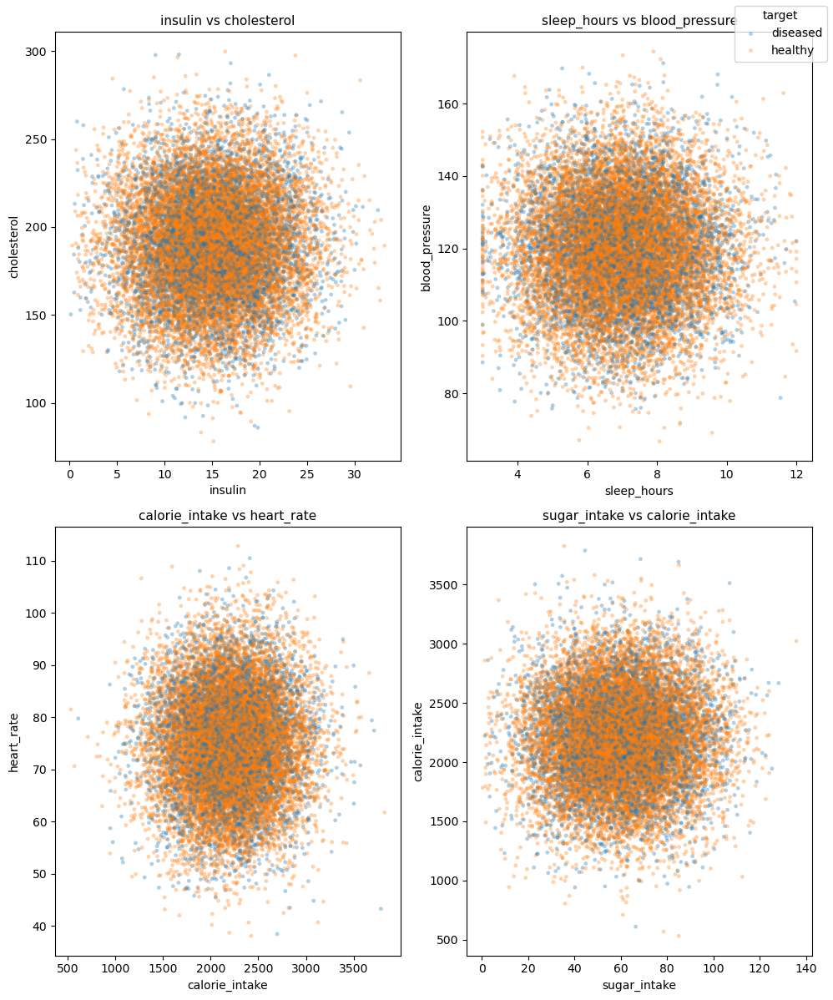

In [25]:
pairs = [
    ('insulin', 'cholesterol', 'insulin vs cholesterol'),
    ('sleep_hours', 'blood_pressure', 'sleep_hours vs blood_pressure'),
    ('calorie_intake', 'heart_rate', 'calorie_intake vs heart_rate'),
    ('sugar_intake', 'calorie_intake', 'sugar_intake vs calorie_intake'),
]

palette = {'diseased': 'C0', 'healthy': 'C1'}

fig, axes = plt.subplots(2, 2, figsize=(10, 12))
axes = axes.ravel()

for i, (x, y, title) in enumerate(pairs):
    ax = axes[i]
    g = sns.scatterplot(
        data=df, x=x, y=y,
        hue='target', hue_order=['diseased', 'healthy'],
        palette=palette, s=12, alpha=0.35, linewidth=0,
        ax=ax, legend=('full' if i == 0 else False)
    )
    if i == 0:
        handles, labels = g.get_legend_handles_labels()
        g.legend_.remove()

    ax.set_title(title, fontsize=11)
    ax.set_xlabel(x); ax.set_ylabel(y)

if handles:
    fig.legend(handles[0:], labels[0:], title='target',
               loc='upper right', frameon=True)

plt.tight_layout()
plt.show()

На диаграммах рассеяния не просматривается выраженных трендов - ни линейных, ни нелинейных. Зависимости выглядят слабыми и статистически неубедительными. Как итог сильной взаимосвязи между выбранными парами признаков не обнаружено

Построим ящик с усами для целевого признака, уровня стресса и количества часов сна

In [26]:
import plotly.graph_objects as go

colors = {'healthy': '#1f77b4', 'diseased': '#d62728'}
names  = {'healthy': 'Здоров',   'diseased': 'Болен'}

levels = sorted(df['stress_level'].unique())
levels_str = [str(int(x)) for x in levels]

fig = go.Figure()

for cls, off in [('healthy', 'h'), ('diseased', 'd')]:
    m = df['target'].eq(cls)
    fig.add_trace(go.Box(
        x=df.loc[m, 'stress_level'].astype(int).astype(str),
        y=df.loc[m, 'sleep_hours'],
        name=names[cls],
        marker_color=colors[cls],
        boxpoints='outliers',
        boxmean=True,
        opacity=0.85,
        offsetgroup=off,
        alignmentgroup='all',
    ))

fig.update_layout(
    xaxis_title='stress_level',
    yaxis_title='sleep_hours',
    boxmode='group',
    template='plotly_white',
    height=520, width=950
)
fig.update_xaxes(categoryorder='array', categoryarray=levels_str)

fig.show()


Больные в среднем спят немного меньше, стресс слегка укорачивает сон, однако сильной взаимосвязи на основе полученных данных не было обнаружено

Построим гистограммы для целевого признака и
- stress level
- sleep hours
- work hours

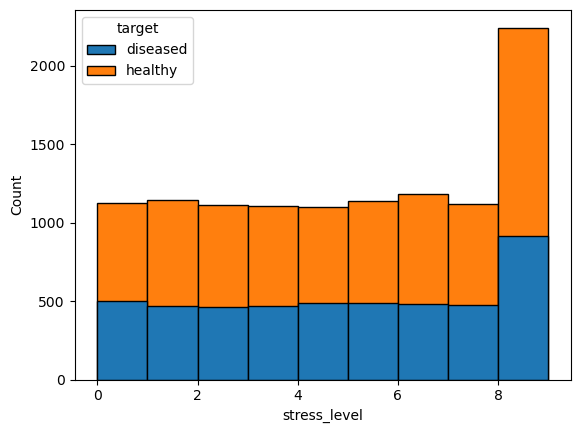

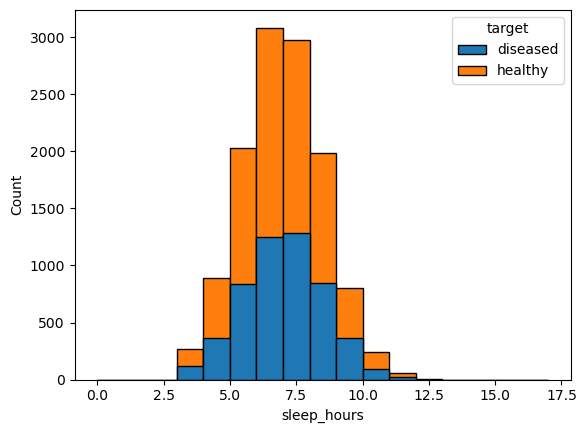

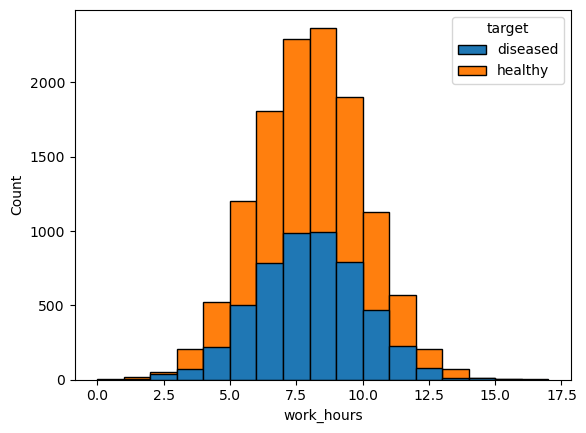

In [27]:
sns.histplot(
    data=df, x='stress_level', hue='target', hue_order=['diseased','healthy'],
    multiple='layer', stat='count', bins=range(0, 10), common_bins=True, alpha=1
)
plt.show()

sns.histplot(
    data=df, x='sleep_hours', hue='target', hue_order=['diseased','healthy'],
    multiple='layer', stat='count', bins=range(0, 18), common_bins=True, alpha=1
)
plt.show()

sns.histplot(
    data=df, x='work_hours', hue='target', hue_order=['diseased','healthy'],
    multiple='layer', stat='count', bins=range(0, 18), common_bins=True, alpha=1
)
plt.show()


На этих признаках никакой сильной связи с целевым признаком нет. Некоторые наблюдения возможны для sleep_hours, но это слишком незначиельно

Нормализуем численные признаки

In [28]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train[numerical_columns] = scaler.fit_transform(X_train[numerical_columns])

Проверим это

In [29]:
X_train[numerical_columns].head()

,age,bmi,blood_pressure,heart_rate,cholesterol,glucose,insulin,sleep_hours,work_hours,daily_steps,calorie_intake,sugar_intake,water_intake,stress_level,meals_per_day
43013,0.229508,0.620141,0.546806,0.481644,0.516134,0.671255,0.473778,0.480072,0.362463,0.226478,0.228580,0.458283,0.459212,0.1,1.00
13815,0.918033,0.609587,0.451271,0.241546,0.415807,0.521306,0.370731,0.490444,0.408524,0.341502,0.430692,0.558192,0.620059,0.8,0.75
26281,0.311475,0.466933,0.567120,0.225699,0.586171,0.913960,0.263783,0.565925,0.495430,0.770040,0.602333,0.483138,0.144379,0.8,0.25
42125,0.393443,0.771950,0.212339,0.635235,0.459096,0.498643,0.596402,0.424873,0.408707,0.487798,0.444010,0.337683,0.362613,0.4,0.25
87804,0.639344,0.188963,0.465737,0.821272,0.411348,0.474937,0.428997,0.855536,0.636544,0.709628,0.459787,0.547848,0.596271,0.3,1.00


Перейдем к преобразованию категориальных признаков в численные при помощи OneHot энкодера

In [30]:
from sklearn.preprocessing import OneHotEncoder

ohe = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
ohe.fit(X_train[categorical_columns])
ohe_columns = ohe.get_feature_names_out(categorical_columns)

X_train_categorical = pd.DataFrame(
    ohe.transform(X_train[categorical_columns]),
    columns=ohe.get_feature_names_out(categorical_columns),
    index=X_train.index
)
X_test_categorical = pd.DataFrame(
    ohe.transform(X_test[categorical_columns]),
    columns=ohe.get_feature_names_out(categorical_columns),
    index=X_test.index
)

X_train = pd.concat([X_train[numerical_columns], X_train_categorical], axis=1)
X_test = pd.concat([X_test[numerical_columns], X_test_categorical], axis=1)

Проверим это

In [31]:
X_train[ohe_columns].head()

,gender_Female,gender_Male,sleep_quality_Excellent,sleep_quality_Fair,sleep_quality_Good,sleep_quality_Poor,alcohol_consumption_Occasionally,alcohol_consumption_Regularly,smoking_level_Heavy,smoking_level_Light,smoking_level_Non-smoker,diet_type_Keto,diet_type_Omnivore,diet_type_Vegan,diet_type_Vegetarian,exercise_type_Cardio,exercise_type_Mixed,exercise_type_Strength,sunlight_exposure_High,sunlight_exposure_Low,sunlight_exposure_Moderate,caffeine_intake_High,caffeine_intake_Moderate
43013,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0
13815,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0
26281,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
42125,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
87804,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0


In [32]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13654 entries, 43013 to 76357
Data columns (total 38 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   age                               13654 non-null  float64
 1   bmi                               13654 non-null  float64
 2   blood_pressure                    13654 non-null  float64
 3   heart_rate                        13654 non-null  float64
 4   cholesterol                       13654 non-null  float64
 5   glucose                           13654 non-null  float64
 6   insulin                           13654 non-null  float64
 7   sleep_hours                       13654 non-null  float64
 8   work_hours                        13654 non-null  float64
 9   daily_steps                       13654 non-null  float64
 10  calorie_intake                    13654 non-null  float64
 11  sugar_intake                      13654 non-null  float64
 12  water

Всё верно сделано. Отметим, что после всех операций осталось всего ~20000 записей

Итак, все задания первой лабораторной работы выполнены:
- [x] Очистка данных (удаление пропусков, нормализация, удаление дубликатов)
- Визуализация значимых признаков:
  - [x] диаграммы рассеяния
  - [x] ящики с усами
  - [x] гистограммы
- [x] Корреляция данных (матрица корреляций)

Метод опорных векторов (SVM)

In [33]:
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
import numpy as np
import pandas as pd

# Кросс-валидация для надежной оценки
cv = StratifiedKFold(n_splits=5)
f1_scores = []
recall_scores = []
precision_scores = []
all_reports = []

for fold, (train_idx, val_idx) in enumerate(cv.split(X_train, y_train)):
    # Разделение на train/val для фолда
    X_fold_train, X_fold_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
    y_fold_train, y_fold_val = y_train.iloc[train_idx], y_train.iloc[val_idx]

    # Масштабирование и обучение
    scaler = StandardScaler()
    X_fold_train_scaled = scaler.fit_transform(X_fold_train)
    X_fold_val_scaled = scaler.transform(X_fold_val)

    # Обучение модели
    model = SVC(kernel='linear', C=2.5, class_weight='balanced',
                random_state=42)
    model.fit(X_fold_train_scaled, y_fold_train)

    # Предсказание и оценка
    y_pred = model.predict(X_fold_val_scaled)
    report = classification_report(y_fold_val, y_pred, output_dict=True)

    # Сохраняем метрики
    f1_scores.append(report['diseased']['f1-score'])
    recall_scores.append(report['diseased']['recall'])
    precision_scores.append(report['diseased']['precision'])
    all_reports.append(report)

    print(f"Fold {fold + 1}:")
    print(f"  Precision: {report['diseased']['precision']:.4f}")
    print(f"  Recall:    {report['diseased']['recall']:.4f}")
    print(f"  F1-score:  {report['diseased']['f1-score']:.4f}")
    print("-" * 40)

# Вывод средних результатов
print("\n" + "="*50)
print("CROSS-VALIDATION RESULTS SUMMARY:")
print("="*50)
print(f"Mean Precision (diseased): {np.mean(precision_scores):.4f} (+/- {np.std(precision_scores):.4f})")
print(f"Mean Recall (diseased):    {np.mean(recall_scores):.4f} (+/- {np.std(recall_scores):.4f})")
print(f"Mean F1-score (diseased):  {np.mean(f1_scores):.4f} (+/- {np.std(f1_scores):.4f})")

# Создаем усредненный classification report
avg_report = {
    'diseased': {
        'precision': np.mean(precision_scores),
        'recall': np.mean(recall_scores),
        'f1-score': np.mean(f1_scores),
        'support': len(y_train[y_train == 'diseased']) // 5  # примерное значение
    },
    'healthy': {
        'precision': np.mean([r['healthy']['precision'] for r in all_reports]),
        'recall': np.mean([r['healthy']['recall'] for r in all_reports]),
        'f1-score': np.mean([r['healthy']['f1-score'] for r in all_reports]),
        'support': len(y_train[y_train == 'healthy']) // 5
    }
}

# Вывод в формате классической таблицы
print("\n" + "="*50)
print("AVERAGED CLASSIFICATION REPORT:")
print("="*50)

# Форматируем вывод как стандартный classification report
print(f"{'':15} {'precision':10} {'recall':10} {'f1-score':10} {'support':10}")
print(f"{'diseased':15} {avg_report['diseased']['precision']:10.4f} "
      f"{avg_report['diseased']['recall']:10.4f} "
      f"{avg_report['diseased']['f1-score']:10.4f} "
      f"{avg_report['diseased']['support']:10}")

print(f"{'healthy':15} {avg_report['healthy']['precision']:10.4f} "
      f"{avg_report['healthy']['recall']:10.4f} "
      f"{avg_report['healthy']['f1-score']:10.4f} "
      f"{avg_report['healthy']['support']:10}")

# accuracy и средние
accuracy_scores = [r['accuracy'] for r in all_reports]
print(f"{'accuracy':15} {'':10} {'':10} {'':10} {np.mean(accuracy_scores):10.4f}")
print(f"{'macro avg':15} {np.mean([avg_report['diseased']['precision'], avg_report['healthy']['precision']]):10.4f} "
      f"{np.mean([avg_report['diseased']['recall'], avg_report['healthy']['recall']]):10.4f} "
      f"{np.mean([avg_report['diseased']['f1-score'], avg_report['healthy']['f1-score']]):10.4f} "
      f"{avg_report['diseased']['support'] + avg_report['healthy']['support']:10}")

# Теперь обучим финальную модель на всех данных и получим отчет на тестовом наборе
print("\n" + "="*50)
print("FINAL MODEL TEST RESULTS:")
print("="*50)

# Обучаем на всех тренировочных данных
final_scaler = StandardScaler()
X_train_scaled = final_scaler.fit_transform(X_train)
X_test_scaled = final_scaler.transform(X_test)

final_model = SVC(kernel='linear', C=2.5, class_weight='balanced', random_state=42)
final_model.fit(X_train_scaled, y_train)

# Предсказания на тестовом наборе
y_pred_test = final_model.predict(X_test_scaled)

# Полная таблица classification report
print(classification_report(y_test, y_pred_test, target_names=['diseased', 'healthy']))

Fold 1:
  Precision: 0.2876
  Recall:    0.5396
  F1-score:  0.3752
----------------------------------------
Fold 2:
  Precision: 0.3144
  Recall:    0.5198
  F1-score:  0.3918
----------------------------------------
Fold 3:
  Precision: 0.2962
  Recall:    0.5136
  F1-score:  0.3757
----------------------------------------
Fold 4:
  Precision: 0.3028
  Recall:    0.5037
  F1-score:  0.3783
----------------------------------------
Fold 5:
  Precision: 0.2965
  Recall:    0.5186
  F1-score:  0.3773
----------------------------------------

CROSS-VALIDATION RESULTS SUMMARY:
Mean Precision (diseased): 0.2995 (+/- 0.0089)
Mean Recall (diseased):    0.5191 (+/- 0.0117)
Mean F1-score (diseased):  0.3797 (+/- 0.0062)

AVERAGED CLASSIFICATION REPORT:
                precision  recall     f1-score   support   
diseased            0.2995     0.5191     0.3797        808
healthy             0.7071     0.4890     0.5778       1922
accuracy                                             0.4979
macro 